In [1]:
library(tidyverse)
library(plotly)
library(ggplot2)

-- Attaching packages --------------------------------------- tidyverse 1.3.2 --
v ggplot2 3.4.1     v purrr   1.0.1
v tibble  3.1.8     v dplyr   1.1.0
v tidyr   1.3.0     v stringr 1.5.0
v readr   2.1.4     v forcats 1.0.0
-- Conflicts ------------------------------------------ tidyverse_conflicts() --
x dplyr::filter() masks stats::filter()
x dplyr::lag()    masks stats::lag()

Attaching package: 'plotly'


The following object is masked from 'package:ggplot2':

    last_plot


The following object is masked from 'package:stats':

    filter


The following object is masked from 'package:graphics':

    layout




# 1. Law of large numbers

## Example 1: Coin Flip

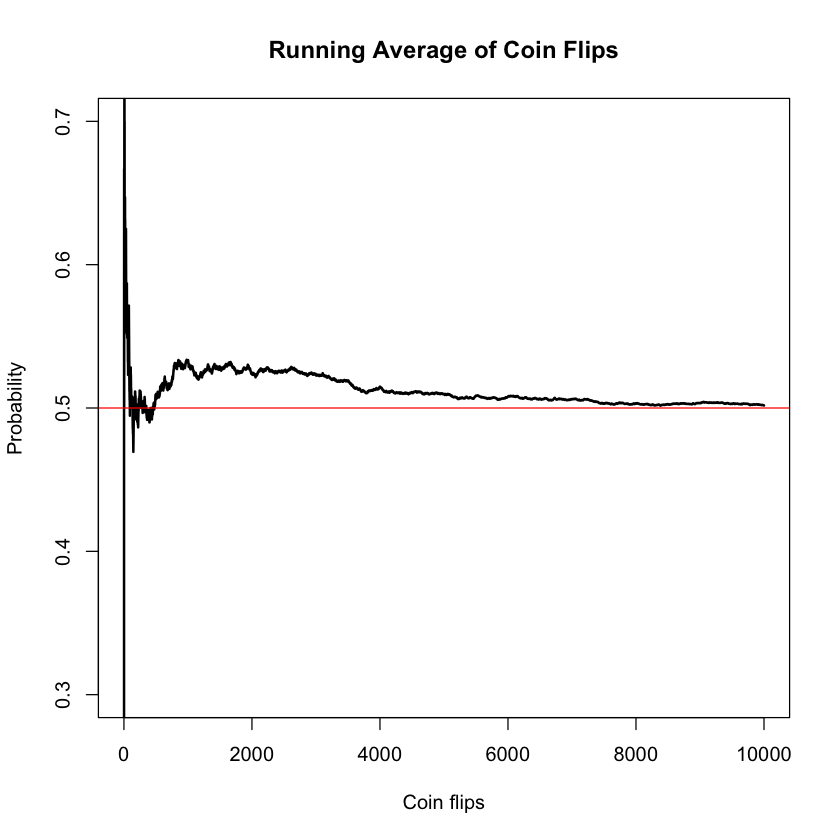

In [2]:
# Set the number of coin flips
N = 10000

# Generate a random sequence of 0s and 1s (representing coin flips)
x <- sample(0:1, N, replace = T)

# Compute the cumulative sum of the sequence
s <- cumsum(x)

# Calculate the running average at each step
Avg <- s / (1:N)

# Adjust the scientific notation display on the x-axis for large observation counts
options(scipen = 10)

# Plot the running average with specific settings
plot(Avg, ylim=c(.30, .70), type = "l", xlab = "Coin flips", ylab = "Probability", main = "Running Average of Coin Flips", lwd = 2)

# Add a horizontal line at y = 0.5 (representing the expected average for a fair coin)
abline(h=0.5, col="red")

## Example 2: Explain this behavior.

_Gamma distribution density_

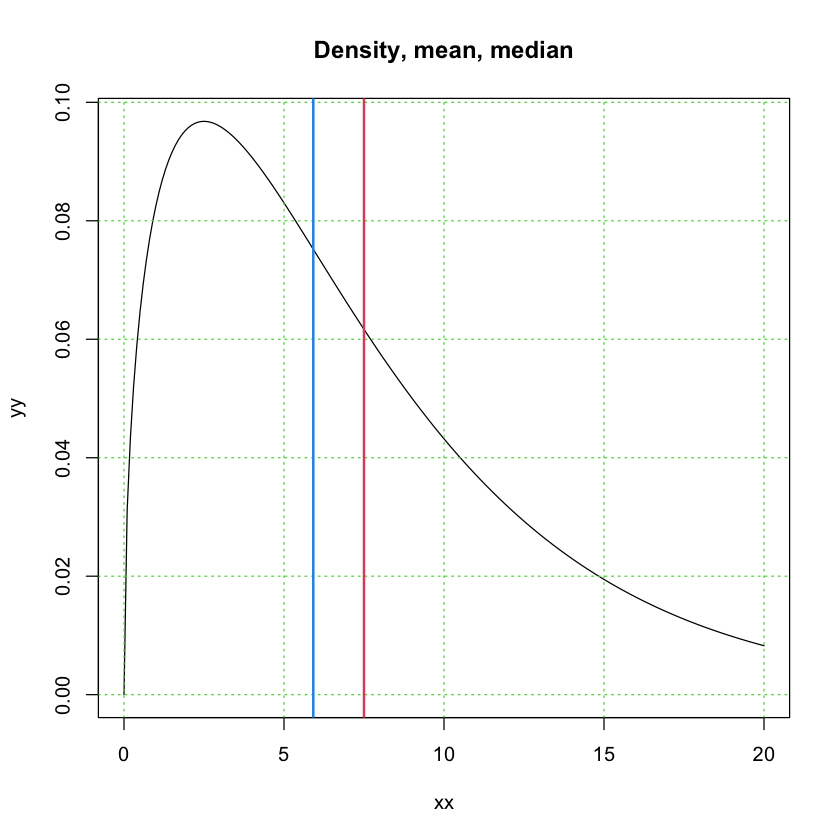

In [3]:
# Set shape and rate parameters for the gamma distribution
myshape = 1.5
myrate = 0.2

# Generate a sequence of x values
xx = seq(0, 20, by = 0.1)

# Compute the probability density function (PDF) values for the gamma distribution
yy = dgamma(xx, shape = myshape, rate = myrate)

# Plot the gamma distribution
plot(xx, yy, type = "l", main = "Density, mean, median")

# Add a grid with a specified color
grid(col = 3)

# Add a vertical line at the mean of the gamma distribution
abline(v = myshape / myrate, col = 2, lwd = 2)

# Add a vertical line at the median of the gamma distribution
abline(v = qgamma(0.5, myshape, myrate), col = 4, lwd = 2)


Median in blue, mean in red.

The mean is larger than the mean since the distribution is heavily skewed to the right.


a. Simulate a single sample mean

In [4]:
n = 10   
mean(rgamma(n,shape = myshape, rate = myrate))

[1] 5.746023

b. Simulate many sample means and make a boxplot 

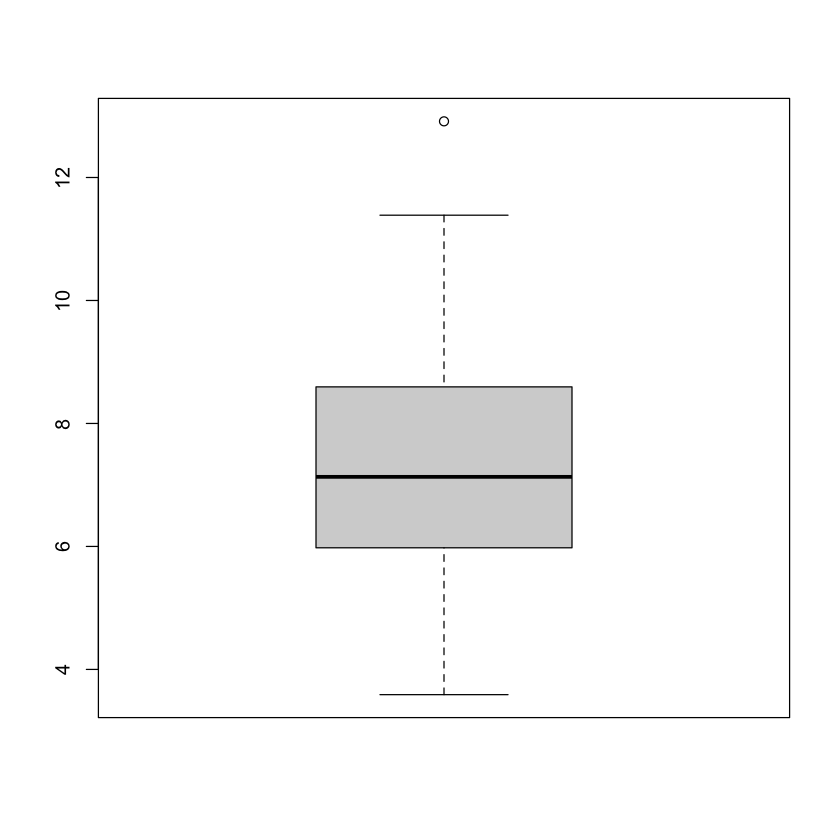

In [5]:
n = 10    # sample size
k = 100   # number of sample means to simulate
s <- replicate(k,mean(rgamma(n,shape = myshape, rate = myrate)))
boxplot(s) #we are looking at how the mean is distributed

Sample mean is a little closer to the actual mean $\alpha / \beta = 1.5/.2 = 7.5$.

c. Simulate many sample means for several different sample sizes and make side by side boxplots

,x10,x20,x40,x80
,<dbl>,<dbl>,<dbl>,<dbl>
1,5.478614,8.358644,7.653280,6.899299
2,4.282257,7.870235,8.463587,7.944066
3,9.574532,7.783249,7.879358,8.144126
4,7.752482,5.175935,6.486152,7.442977
5,5.972968,7.991664,8.105389,8.182465
6,4.777149,9.042353,8.212430,6.347155


[1] 1000    4

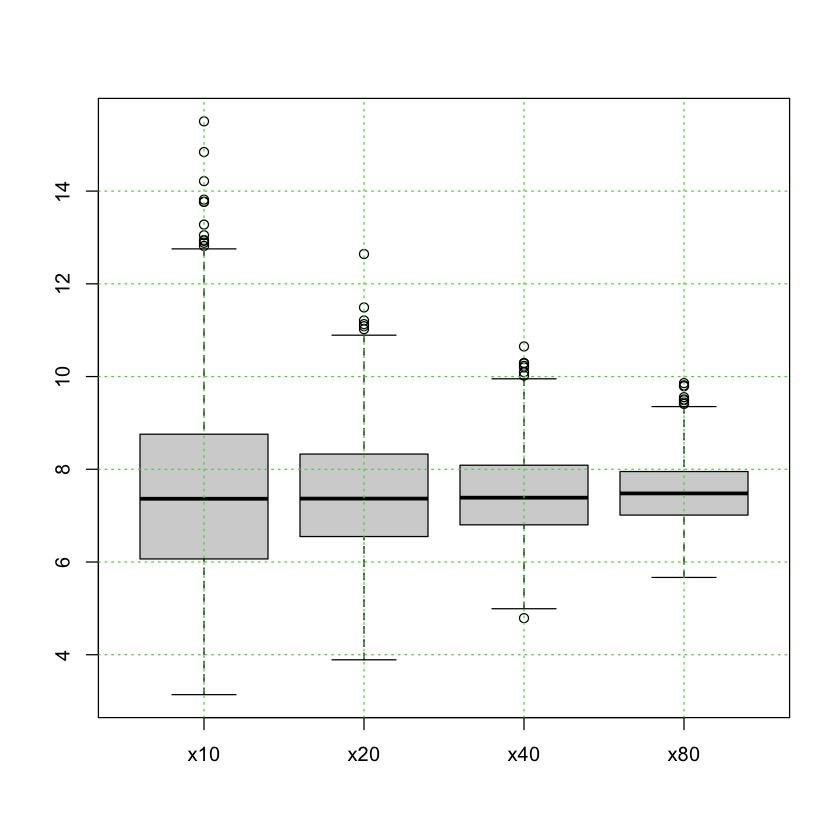

In [6]:
k = 1000  # number of simulations for each set of sample means
mydf.3 = data.frame(x10 = rep(NA,k))  # data frame to store it all

n = 10  # for sample size 10
mydf.3$x10 = replicate(k,mean(rgamma(n,shape = myshape, rate = myrate))) 

n = 20  # for sample size 20
mydf.3$x20 = replicate(k,mean(rgamma(n,shape = myshape, rate = myrate))) 

n = 40  # for sample size 40
mydf.3$x40 = replicate(k,mean(rgamma(n,shape = myshape, rate = myrate))) 

n = 80  # for sample size 80
mydf.3$x80 = replicate(k,mean(rgamma(n,shape = myshape, rate = myrate))) 

head(mydf.3)
dim(mydf.3)

boxplot(mydf.3)
grid(col = 3)

__The boxplots become more compressed about a value near 7.5 and also  more symmetrical. Give a precise mathematical description of this behavior.__

=> Law of large numbers


## Example 3:

For the parameters chosen here, the mean is 7.5.

Make several additional sets of sample means and box plots. 

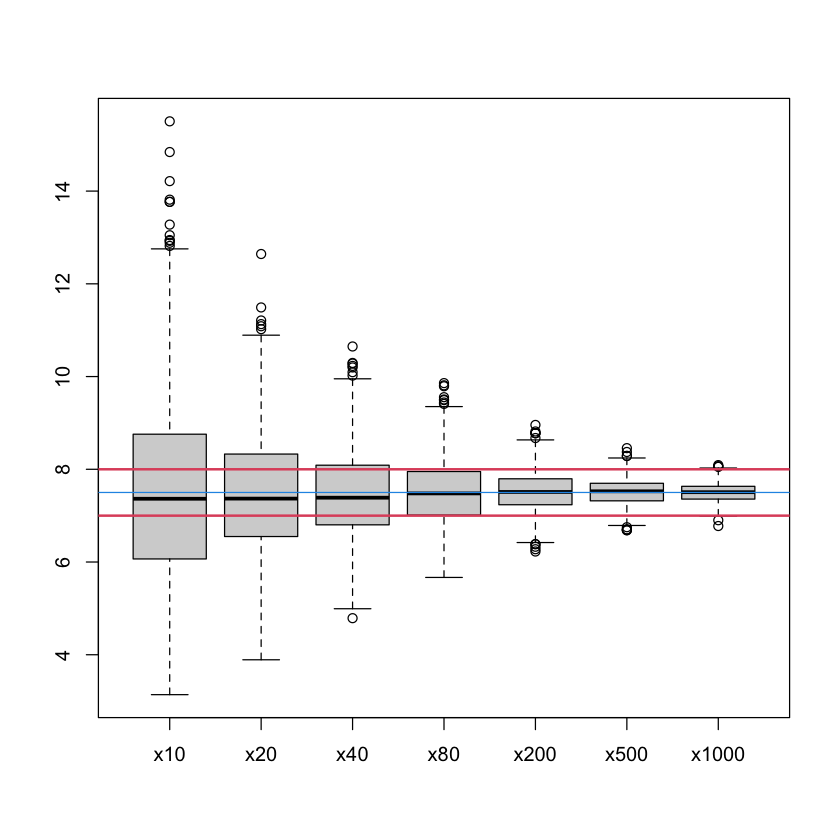

In [7]:
k = 1000


n = 200  # for sample size 200
mydf.3$x200 = replicate(k,mean(rgamma(n,shape = myshape, rate = myrate))) 

n = 500  # for sample size 500
mydf.3$x500 = replicate(k,mean(rgamma(n,shape = myshape, rate = myrate))) 

n = 1000  # for sample size 1000
mydf.3$x1000 = replicate(k,mean(rgamma(n,shape = myshape, rate = myrate))) 


boxplot(mydf.3)

mymean = myshape/myrate

myepsilon = .5


abline(h = mymean, col = 4)  # plot the mean in blue
abline(h = mymean + myepsilon, col = 2, lwd = 2 )  # plot mean plus/minus epsilon in red 
abline(h = mymean - myepsilon, col = 2, lwd = 2 )

## Example 4: What can you observe here?

In [8]:
mylambda=0.5
mydf = data.frame(x10 = rep(NA,k))  # data frame to store it all
mysize <- c(10,20,40,80,200,500,1000)

for (j in 1:7){
  mydf[,j] = replicate(k,mean(rexp(mysize[j], rate=mylambda)))  
}


colnames(mydf) <- c("x10","x20","x40","x80","x200","x500","x1000")
head(mydf)

,x10,x20,x40,x80,x200,x500,x1000
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,2.3384743,1.933211,1.614342,1.746829,2.000525,1.973312,2.072016
2,3.2327814,1.730400,1.683251,1.765607,2.112380,1.956743,2.111838
3,1.2589177,2.507361,1.856705,1.754510,1.958901,1.947410,1.994922
4,3.0335241,1.661026,1.870129,2.109544,1.937621,2.056971,1.936660
5,0.4874476,2.142009,2.303599,1.970513,2.104543,2.016264,2.095540
6,1.6504624,1.949277,1.498259,2.311184,1.952615,2.112058,2.010384


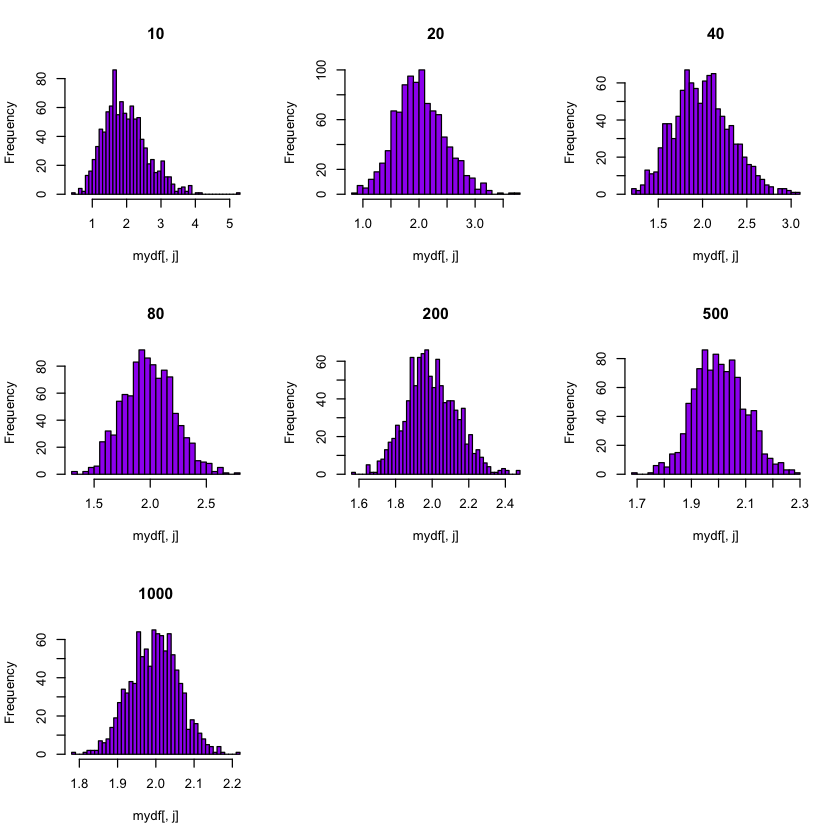

In [9]:
par(mfrow = c(3,3))
for (j in 1:7){
  hist(mydf[,j],col = 'purple', breaks = 40, main = paste("n"=mysize[j]))
}

# 2. Central Limit Theorem

## Example 5:

Loading required package: gridExtra


Attaching package: 'gridExtra'


The following object is masked from 'package:dplyr':

    combine


Warning message:
"The dot-dot notation (`..density..`) was deprecated in ggplot2 3.4.0.
i Please use `after_stat(density)` instead."


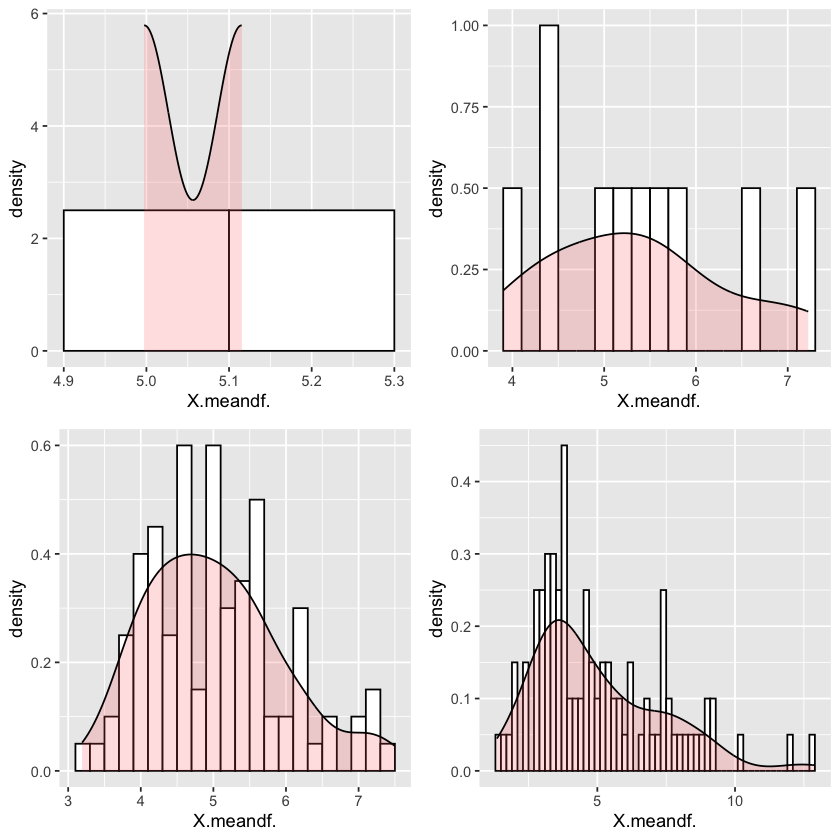

In [10]:
library(ggplot2)

myCLT = function( mylambda=0, mysize = 1,samples=1){
  mydf = data.frame(s1=rep(NA,mysize))
  
  for (j in 1:samples){
    mydf[,j] = (rexp(mysize, rate=mylambda))  
  }
  
  meandf <- apply(mydf,FUN = mean, MARGIN=1)
  
  colnames(meandf) <- NULL
  meandf2 <-data.frame((meandf))
  
  return(ggplot(meandf2, aes( X.meandf.)) +
    geom_histogram(aes(y=..density..), # Histogram with density instead of count on y
                   binwidth=.2,
                   colour="black", fill="white") +
    geom_density(alpha=.2, fill="#FF6666"))
  
}


plot1 = myCLT(mylambda=0.2, mysize = 2,samples=1000)

plot2= myCLT(mylambda=0.2, mysize = 10,samples=30)

plot3 = myCLT(mylambda=0.2, mysize = 100,samples=30)

plot4 = myCLT(mylambda=0.2, mysize = 100,samples=5) # i need a good representative of my population

require(gridExtra)
grid.arrange(plot1, plot2,plot3, plot4 ,ncol=2,nrow=2)

## Example 6:

The mean is shape/rate and the standard deviation is  sqrt(shape)/rate.

"Standardize" all the sample means: Subtract the true mean, divide by true standard deviation, multiply with sqrt(sample size).

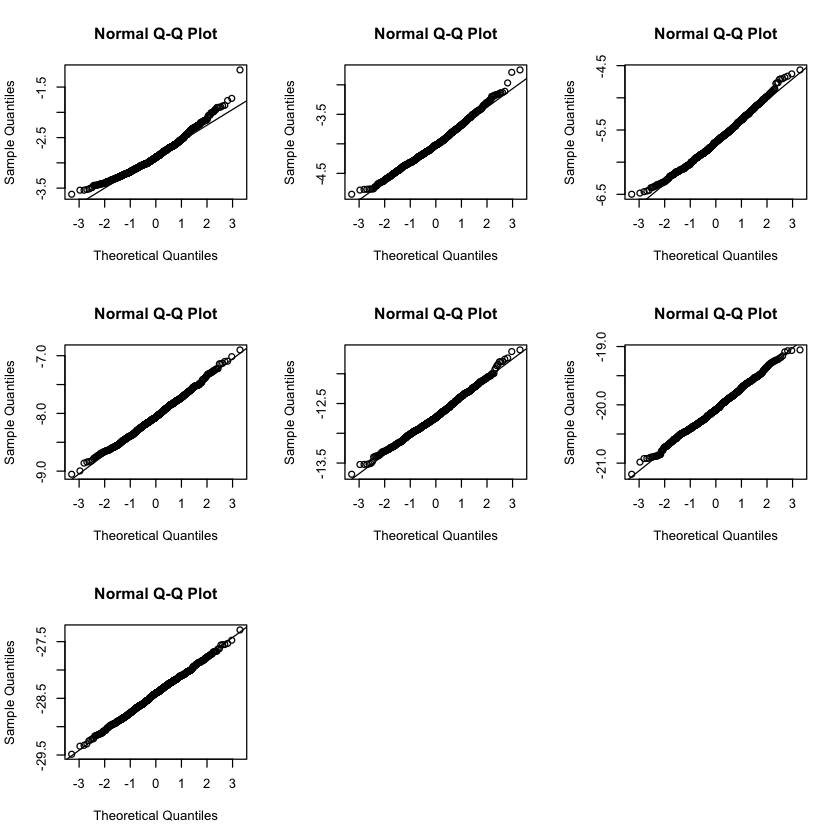

In [11]:
mysd = sqrt(myshape)/myrate # from Wikipedia

mydf.1 <- mydf  # new data frame (means of gamma distribution)
mysize <- c(10,20,40,80,200,500,1000)

for (j in 1:7){
  mydf.1[,j] <- (mydf.1[j]-mymean)/mysd*sqrt(mysize[j])
}

par(mfrow = c(3,3))
for (j in 1:7){
  qqnorm(mydf.1[,j])
  qqline(mydf.1[,j])  
}

The quantile-quantile plots become more and more straight as the sample size increases.

The same without standardizing. The qq-plots look the same. Only the scales are different. 

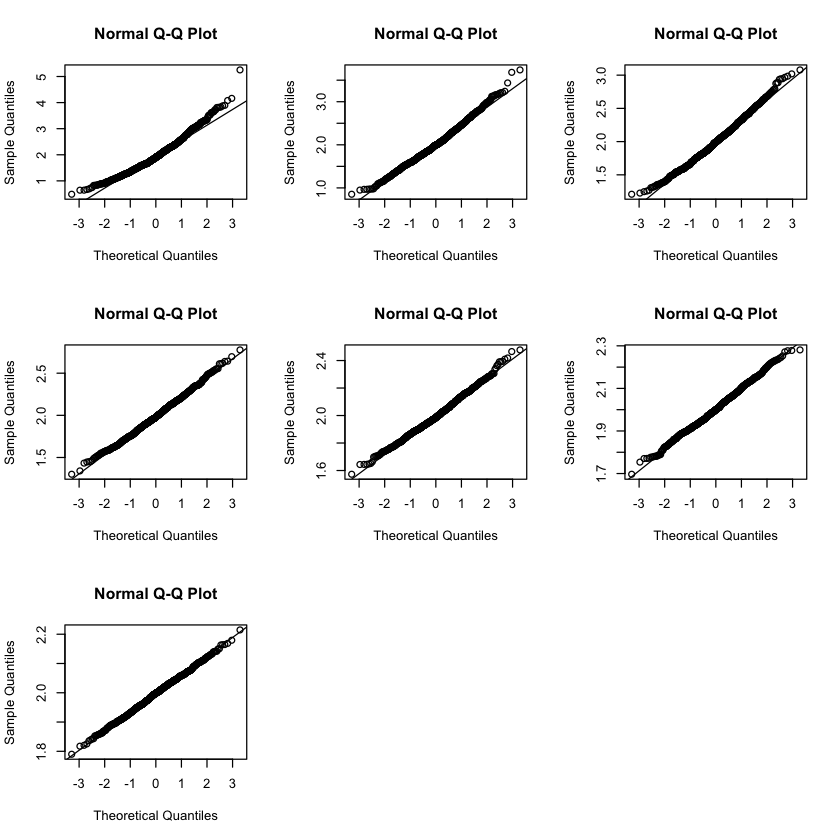

In [12]:
par(mfrow = c(3,3))
for (j in 1:7){
  qqnorm(mydf[,j])
  qqline(mydf[,j])  
}

The same for histograms, after standardizing. For small sample sizes the histograms are skewed to the right. This disappears for larger sample sizes and the histograms become bell-shaped and symmetric.

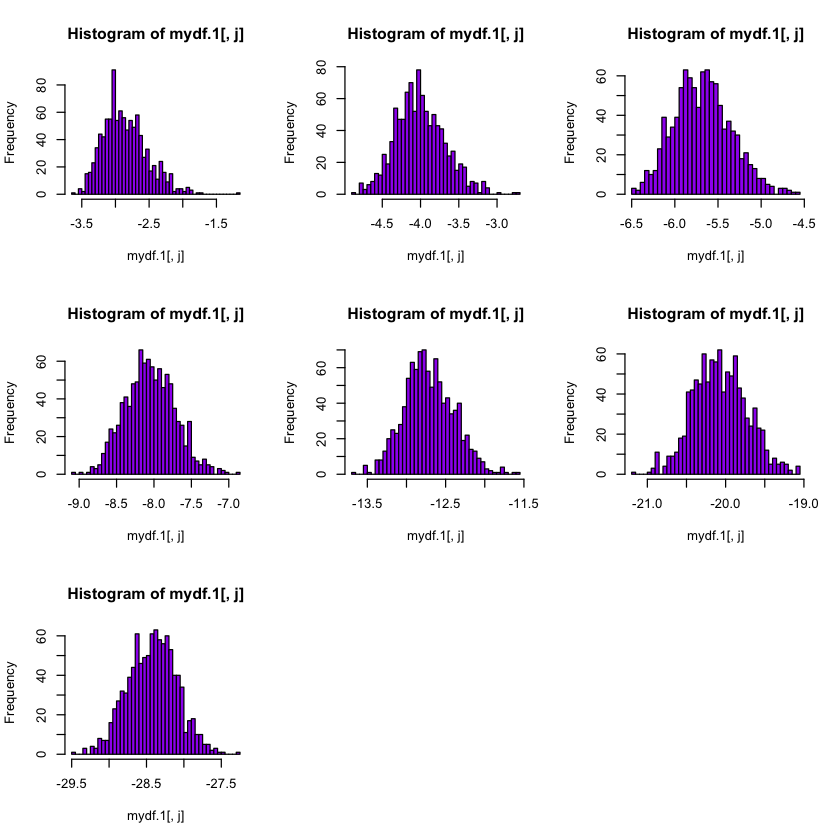

In [13]:
par(mfrow = c(3,3))
for (j in 1:7){
  hist(mydf.1[,j],col = 'purple', breaks = 40)
}

# 3. Likelihood Function

## Example 7:

a. likelihood function for data from Poisson distribution.

![](p1.png)


In [14]:
set.seed(321)

# Likelihood function for Poisson distribution  

mylikeli.poisson = function(lambda,x){
   exp(-length(x)*lambda)*lambda^sum(x)/prod(factorial(x))}

b. Compute several likelihoods

In [15]:
# A sample of size 4

x0 <- c(2,3,3,0)

# Compute several likelihoods

mylikeli.poisson(2,x0)
mylikeli.poisson(1.5,x0)
mylikeli.poisson(3,x0)

[1] 0.001192756

[1] 0.0008823293

[1] 0.0005598914

c. which parameter is more likely?

[1] 2

[1] 2

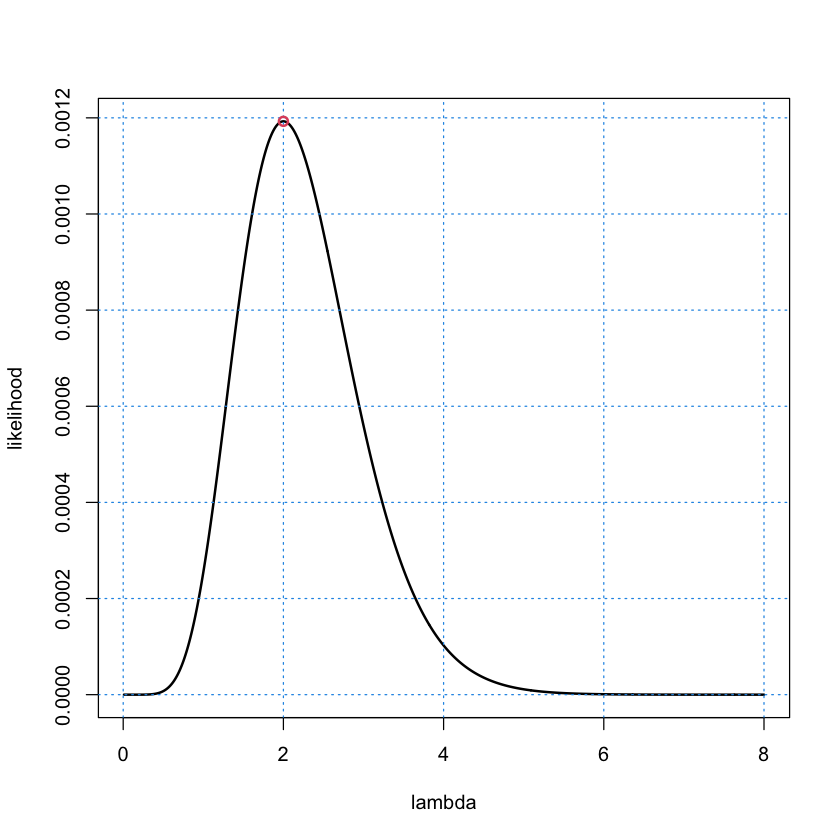

In [16]:
# which parameter is more likely?

t = seq(.01,8,by = .01) #range of lambda

y.1 <- sapply(t,function(t){mylikeli.poisson(t,x0)})

plot(t,y.1, xlab = 'lambda', ylab = 'likelihood',
        type = 'l', lwd = 2)
grid(col = 4)

t[which.max(y.1)] # that is the most likely lambda.


points(2,mylikeli.poisson(2,x0), lwd = 2, col = 2)

#theorotical maximum likelihood estimator for poisson is xbar
(xbar=mean(x0))

d. Prepare to plot likelihood functions for ten different samples

8,3,4,5,5,5,4,2,5,5
7,3,6,1,3,9,5,4,10,1
3,4,4,4,3,7,10,2,5,5
3,3,3,2,5,4,3,5,4,4


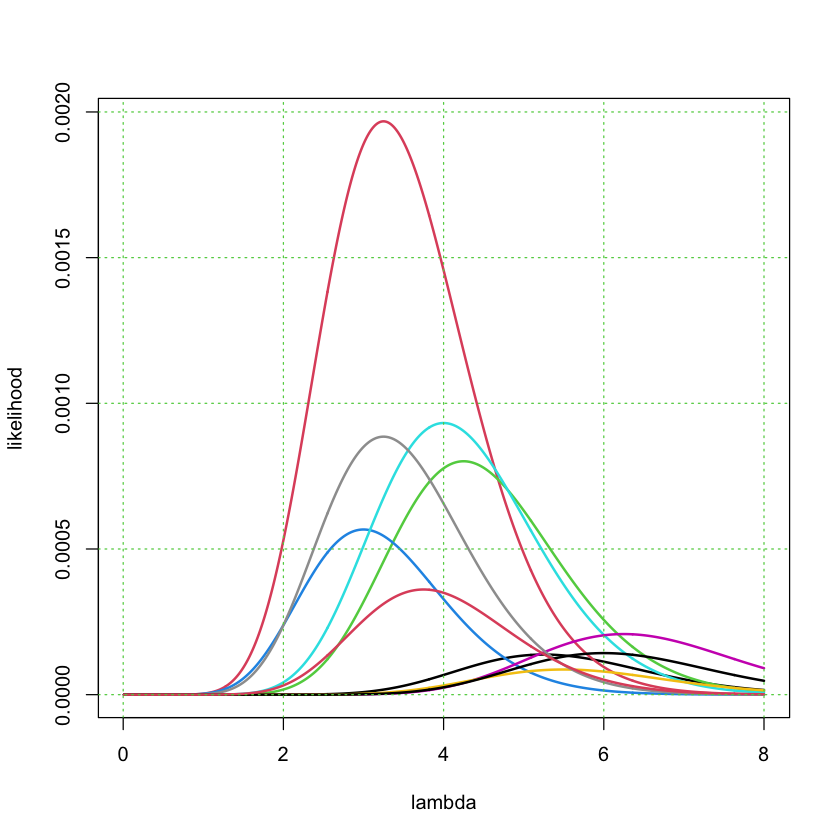

In [17]:
# Prepare to plot likelihood functions for ten different samples

X.0 <- matrix(rpois(40,4), nrow = 4)
X.0

likeli.0 <- matrix(NA, nrow = dim(X.0)[2], ncol = length(t))

for (j in 1:ncol(X.0)){
  x0 <- X.0[,j]
  likeli.0[j,] <- sapply(t,function(t){mylikeli.poisson(t,x0)})
}

plot(t,likeli.0[1,], xlab = 'lambda', ylab = 'likelihood',
        type = 'l', lwd = 2, col = 1, ylim = c(0,max(likeli.0)))
for (j in 2:10){
   lines(t,likeli.0[j,], lwd = 2, col = j)
}

grid(col = 3)

e. Plot the logarithms of the likelihood functions for these samples

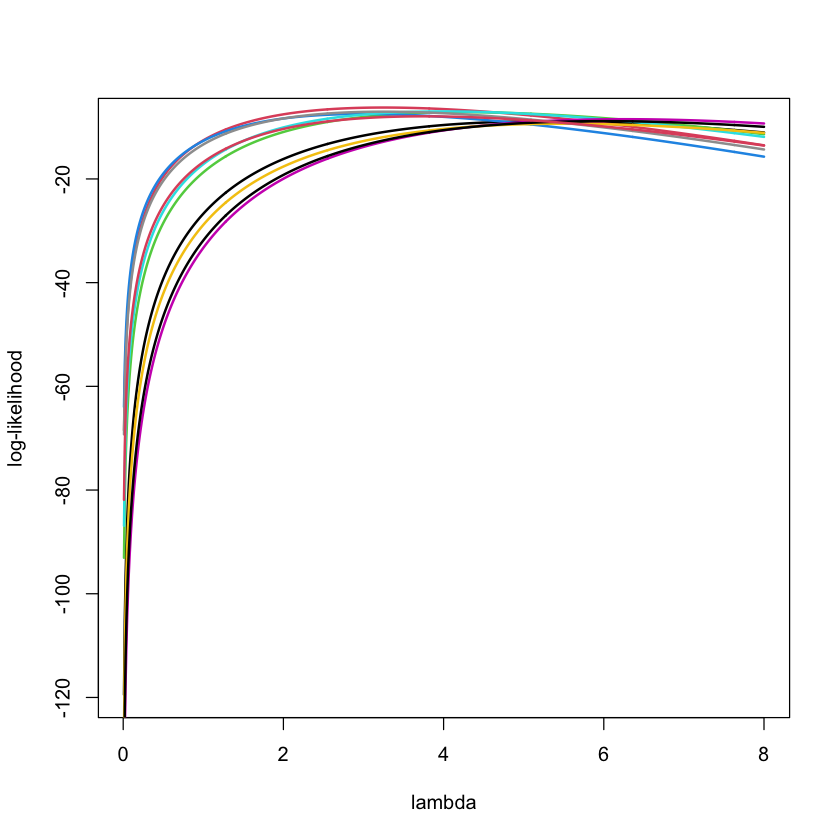

In [18]:
plot(t,log(likeli.0[1,]), xlab = 'lambda', ylab = 'log-likelihood',
       type = 'l', lwd = 2, col = 1)
for (j in 2:10){
 lines(t,log(likeli.0[j,]), lwd = 2, col = j)
}

f. Plot logarithmic likelihood functions for samples of  different size

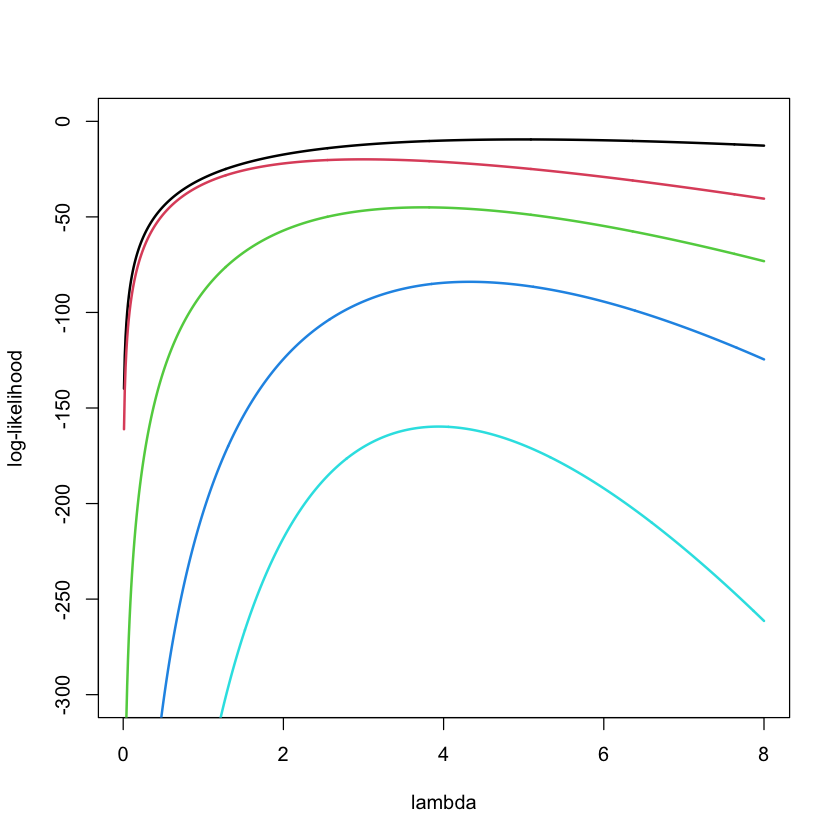

In [19]:
mysize = c(5,10,20,40, 80)
likeli.1 <- matrix(NA, nrow = length(mysize), ncol = length(t))
for (j in 1:length(mysize)){
   mysample <- rpois(mysize[j], lambda = 4)
   likeli.1[j,]  <- sapply(t,function(t){mylikeli.poisson(t,mysample)})
}

plot(t,log(likeli.1[1,]), xlab = 'lambda', ylab = 'log-likelihood',
        type = 'l', lwd = 2, col = 1, ylim = c(-300,0))
for (j in 2:length(mysize)){
  lines(t,log(likeli.1[j,]), lwd = 2, col = j)
}

We can see that my parameter estimation highly depends on the observed values. For different observations, I can estimate different maximum Likelihood estimators for my lambda.

Therefore, given the observations, I will be able to make a good decision on my unknown parameters using these sampled observations.


  

# 4. Method of Moments

## Example 8: Beta Distribution

[1] 2

[1] 3.323351

[1] 1.791759

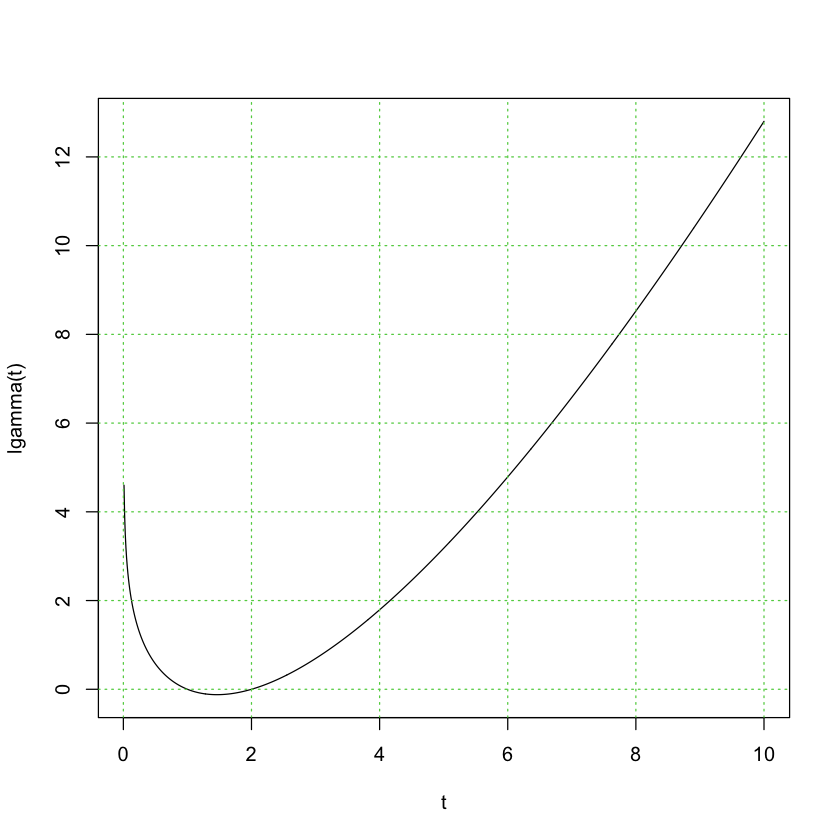

In [20]:
### Gamma function (appears in Beta Distribution)

gamma(3) #gamma function
gamma(3.5)
lgamma(4)#natural logarithm of the absolute value of the gamma function

t = seq(0.01,10,by = .01)

plot(t,lgamma(t), type = 'l')
grid(col = 3)

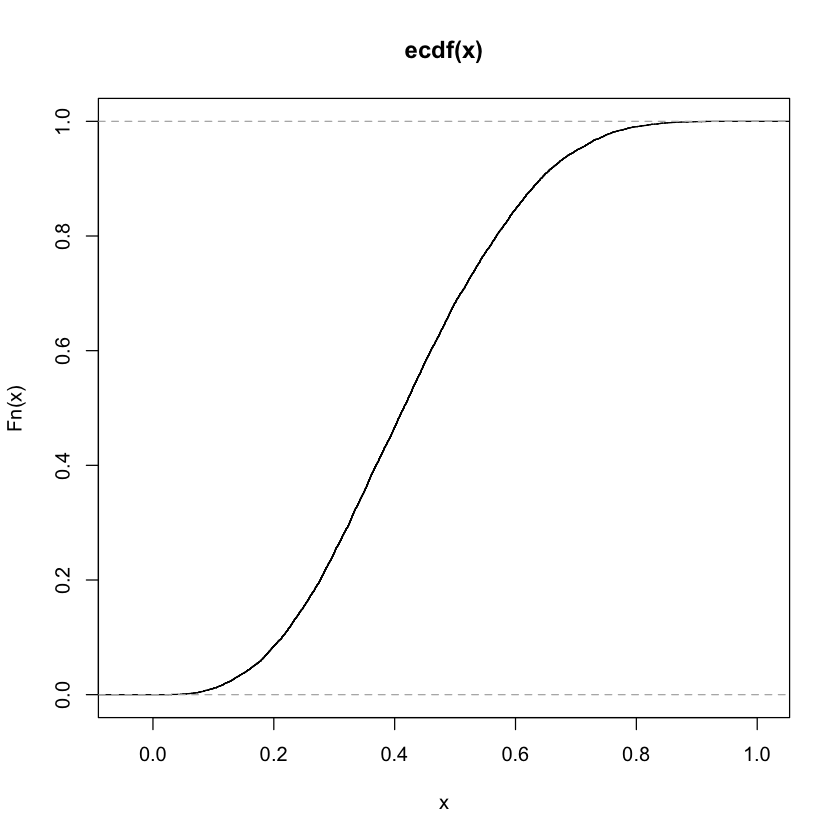

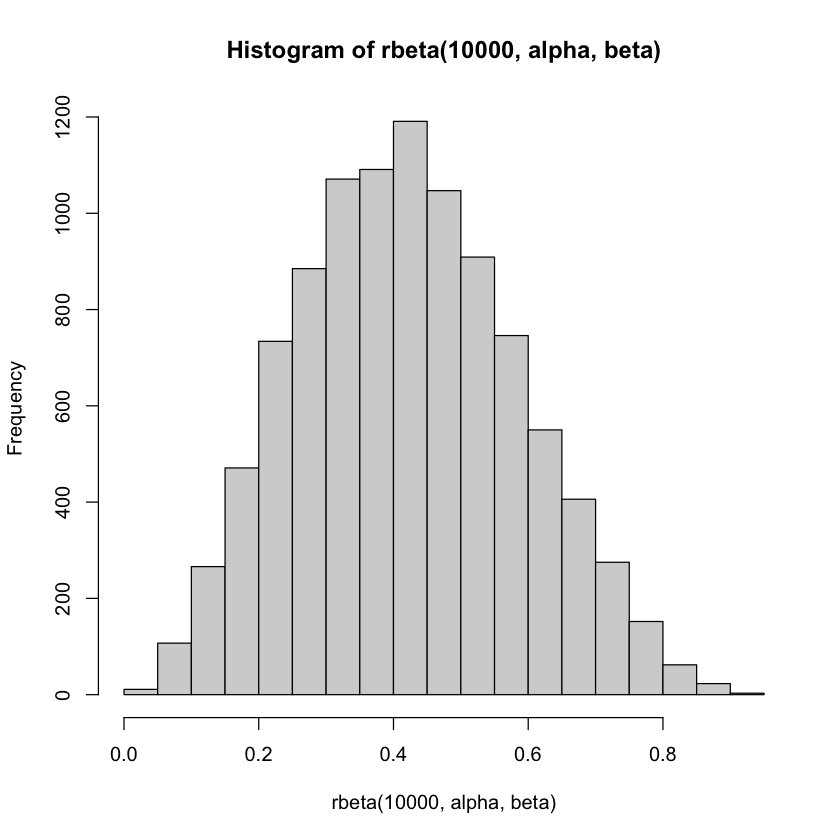

In [21]:
# Beta distribution

alpha = 3.5
beta = 4.8

plot.ecdf(rbeta(10000,alpha,beta))

hist(rbeta(10000,alpha,beta)) 

d. Method of moments estimate 

![](p2.png)

In [22]:
n = 8  # sample size
N = 10000 # number of replications

x <- rbeta(n,alpha,beta)
x.bar <- mean(x)
v.bar <- var(x)

## done in class ##
alpha.hat <- x.bar*(x.bar*(1-x.bar)/v.bar - 1)
beta.hat <- (1-x.bar)*(x.bar*(1-x.bar)/v.bar - 1)

e. How accurate?

In [23]:
# Replicate many estimates from many samples:

beta.mom = function(x){
  x.bar <- mean(x)
  v.bar <- var(x)
  alpha.hat <- x.bar*(x.bar*(1-x.bar)/v.bar - 1)
  beta.hat <- (1-x.bar)*(x.bar*(1-x.bar)/v.bar - 1)
  return(c(alpha.hat, beta.hat))
}

# Simulate many samples of size n

X.1 <- matrix(rbeta(n*N, alpha, beta), ncol = n)

# Eachcolumn of X.1 is a sample
head(X.1)

0.4240831,0.3700643,0.2680962,0.2309385,0.3166059,0.5203743,0.3276369,0.4171579
0.4655358,0.6267039,0.5802947,0.4081005,0.4121668,0.7812837,0.2164925,0.5386230
0.3641531,0.3060638,0.5486317,0.3799083,0.3422142,0.4777149,0.2550388,0.4306768
0.5613924,0.2428736,0.7251090,0.3955596,0.5873112,0.4659420,0.5535957,0.2427434
0.3989334,0.4324891,0.2695043,0.2173831,0.3902289,0.6325108,0.5022343,0.6039076
0.1922581,0.7036816,0.7483027,0.6910057,0.2912827,0.4558085,0.6246618,0.5458300


Make an estimate for each sample and record it as a row in a bew matrix

In [24]:
estimate.beta <- matrix(NA, ncol = 2, nrow = N)
for (j in 1:N){
  estimate.beta[j,] <- beta.mom(X.1[j,])
}


look at estimates

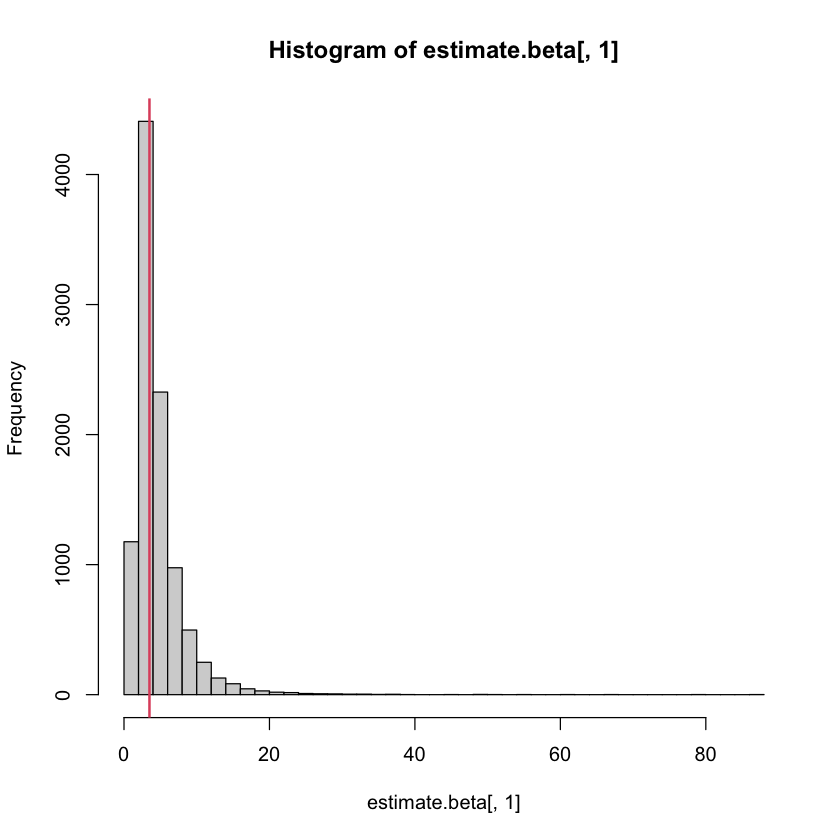

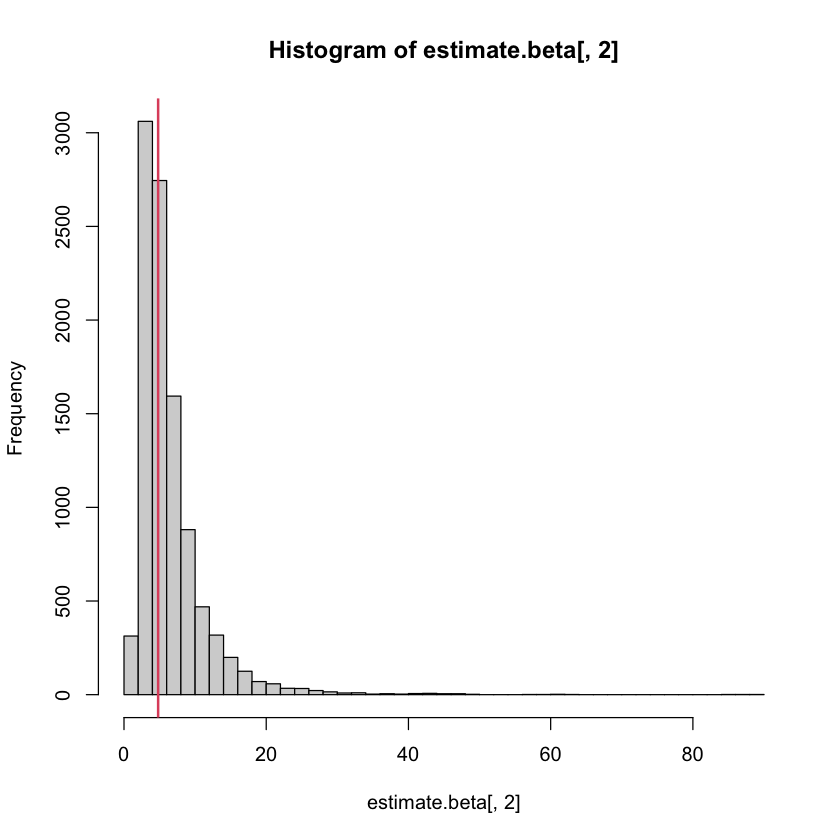

In [25]:
hist(estimate.beta[,1], breaks = 40)
abline(v = alpha, col = 2, lwd = 2) #true alpha

hist(estimate.beta[,2], breaks = 40)
abline(v = beta, col = 2, lwd = 2) #true beta

f. Estimate the bias

In [26]:
colMeans(estimate.beta) - c(alpha, beta)

# Positive bias for both parameters

[1] 1.175842 1.654165

# 5. Relative efficiency

a. Simulate many sample means and medians from a standard normal distribution

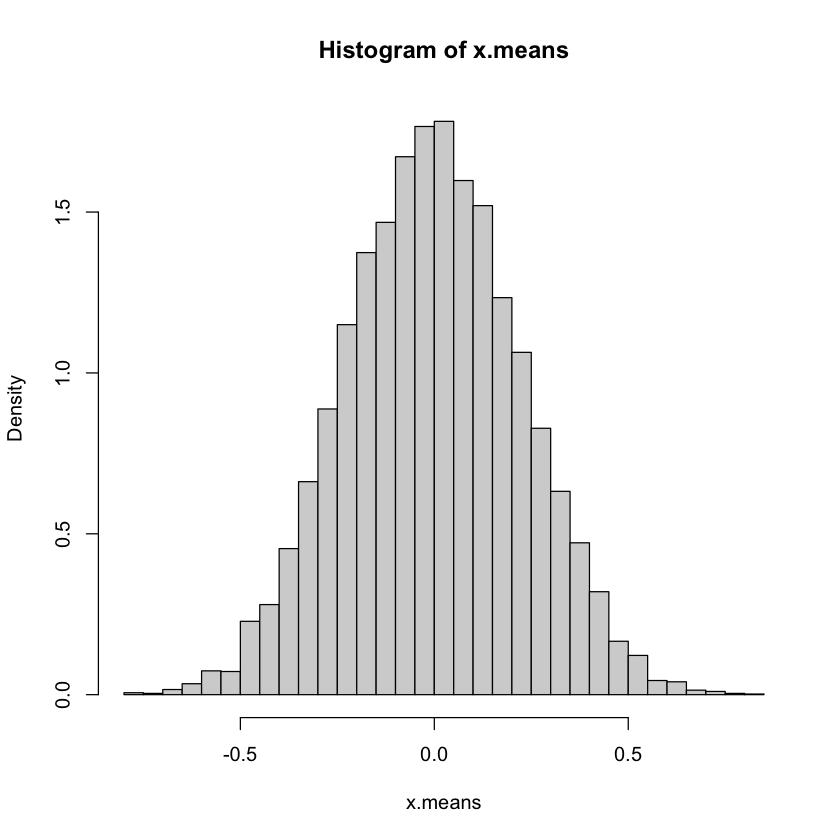

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

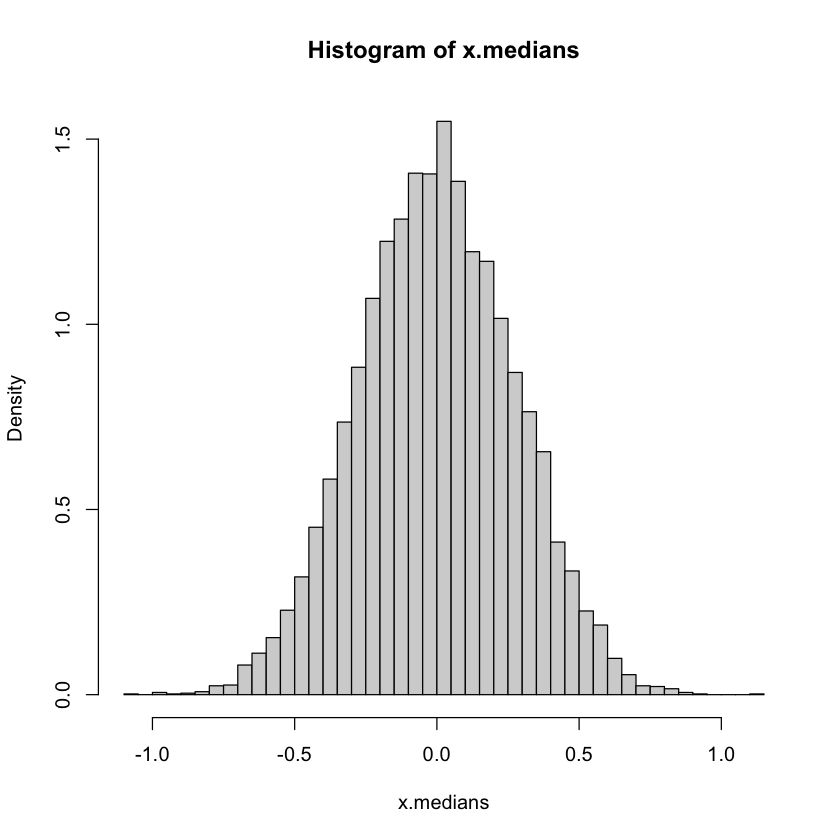

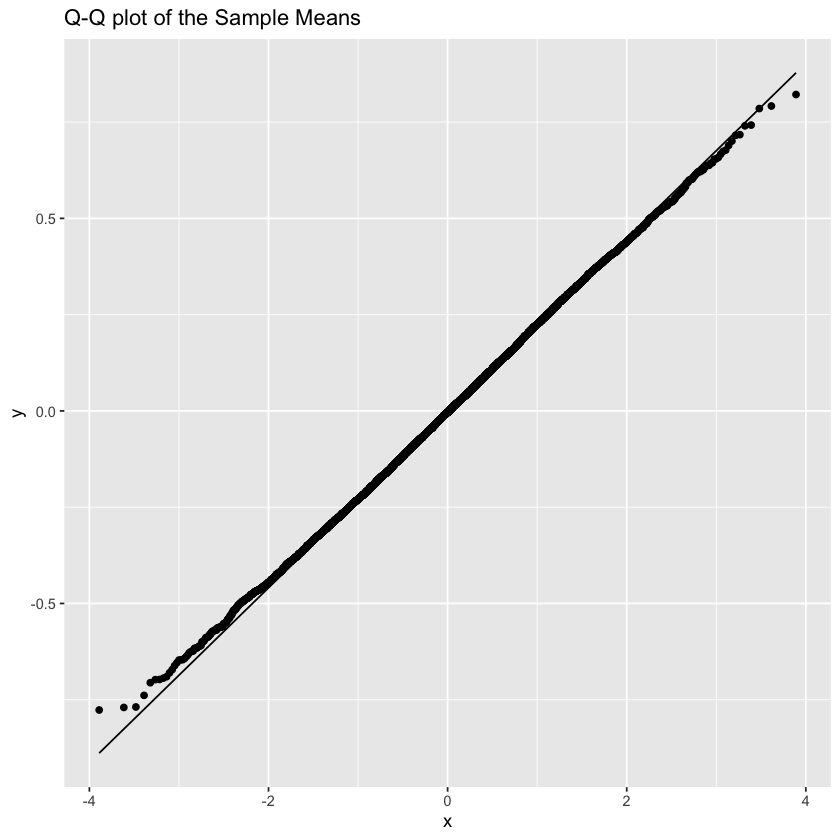

[1] -0.002864082

[1] -0.0007028996

[1] 0.04995903

[1] 0.0737515

[1] 1.47624

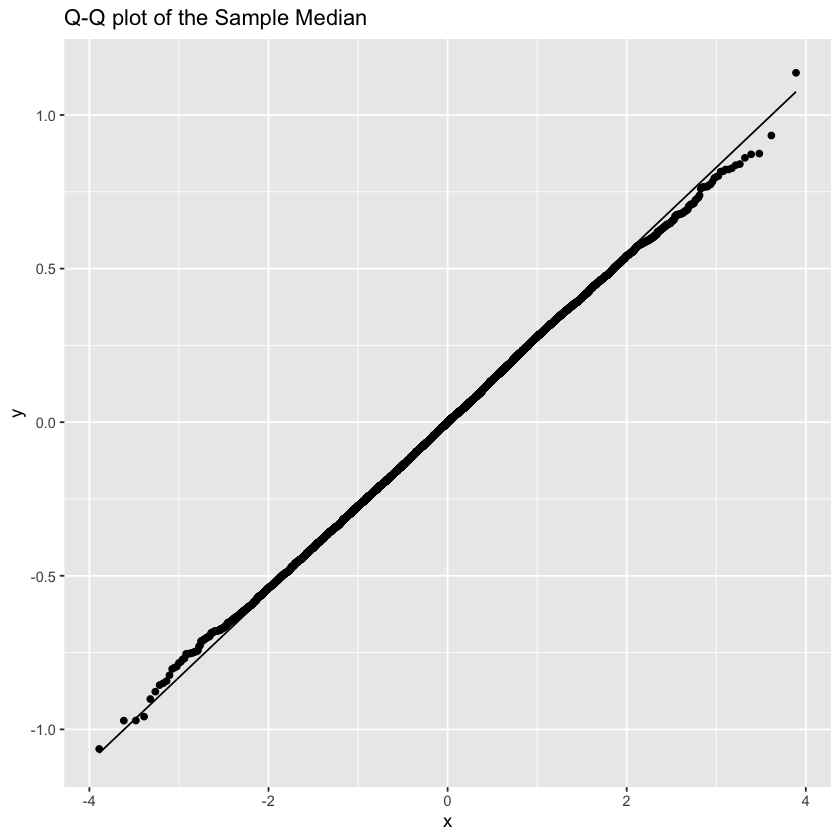

In [27]:
n = 20

x.means <- replicate(10000, mean(rnorm(n)))
x.medians <- replicate(10000, median(rnorm(n)))

hist(x.means, breaks = 50, probability = T)
hist(x.medians, breaks = 50, probability = T)

df <- data.frame(x=x.means,y=x.medians)

fig1 <- plot_ly(df, x = ~x, type = "histogram") %>%
  layout(title = 'Distribution of the Sample Means')
fig1

fig2 <- plot_ly(df, x = ~y, type = "histogram") %>%
  layout(title = 'Distribution of the Sample Median')
fig2

# Both sample statistics have a bell shaped distribution.

#qqnorm(x.means)
#qqnorm(x.medians)


p1 <- ggplot(df, aes(sample = x))
p1 + stat_qq() + stat_qq_line()+
  ggtitle ("Q-Q plot of the Sample Means")

p2 <- ggplot(df, aes(sample = y))
p2 + stat_qq() + stat_qq_line()+
  ggtitle ("Q-Q plot of the Sample Median")


############ means ######


mean(x.means)
mean(x.medians)

# Both are unbiased estimators for the center

var(x.means)
var(x.medians)

# The median has larger variance.

# Here is the relative efficiency of the mean compared to the media:

var(x.medians)/var(x.means)

To achieve the same accuracy, the median would require Sample sizes which are about 48 - 50% larger.

n*E+n=48
(20*1.4+20) #atleast 50% larger than the mean sample size

## Example 9:  Uniform distribution

a. Estimate parameter  a  with max likelihood 

We want to estimate the unknown parameter a in  $U(0,a)$ distribution.

![](1.png)

a. MLE

[1] 1.776437

[1] 0.04001341

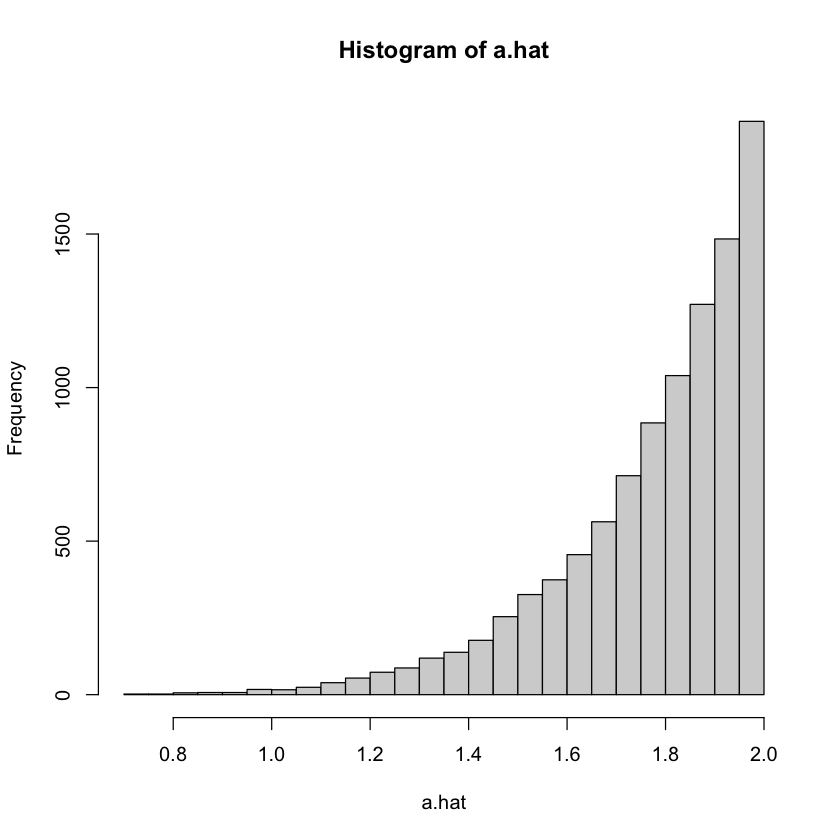

In [28]:
a = 2
n = 8  # sample size
N = 10000 # number of replications

a.hat = replicate(N,max(runif(n,max = a)))

hist(a.hat, breaks = 40)
mean(a.hat)
var(a.hat)
# The bias is approximately  a/(n+1)

b. Estimate parameter a with method of moments

[1] 1.991327

[1] 0.1632641

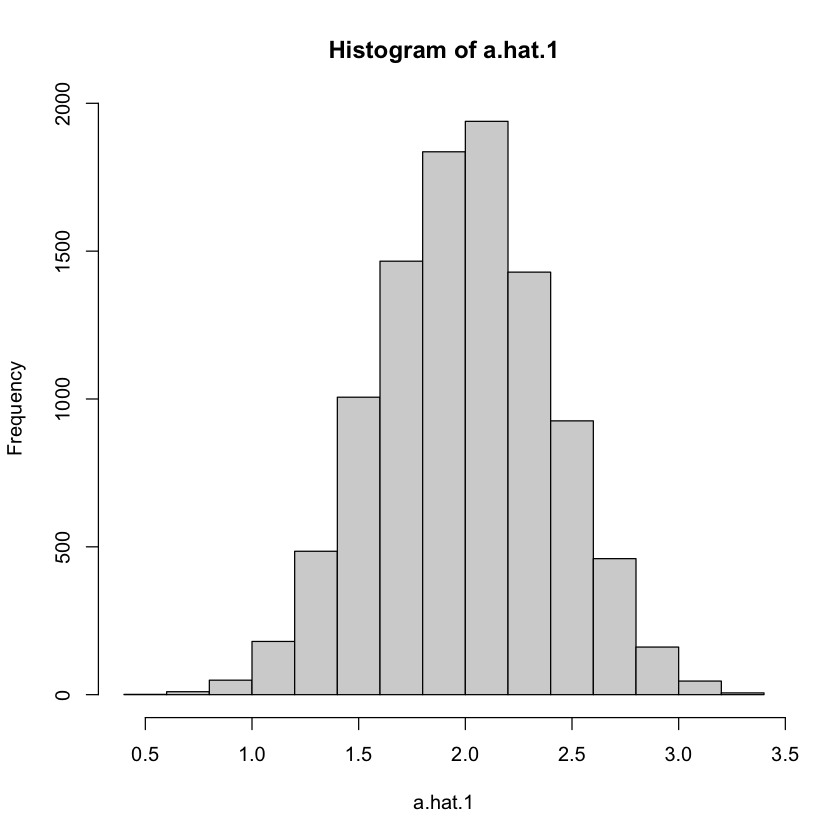

In [29]:
a.hat.1 = replicate(N,2*mean(runif(n,max = a)))

hist(a.hat.1)
mean(a.hat.1)
var(a.hat.1)

c. an unbiased estimater

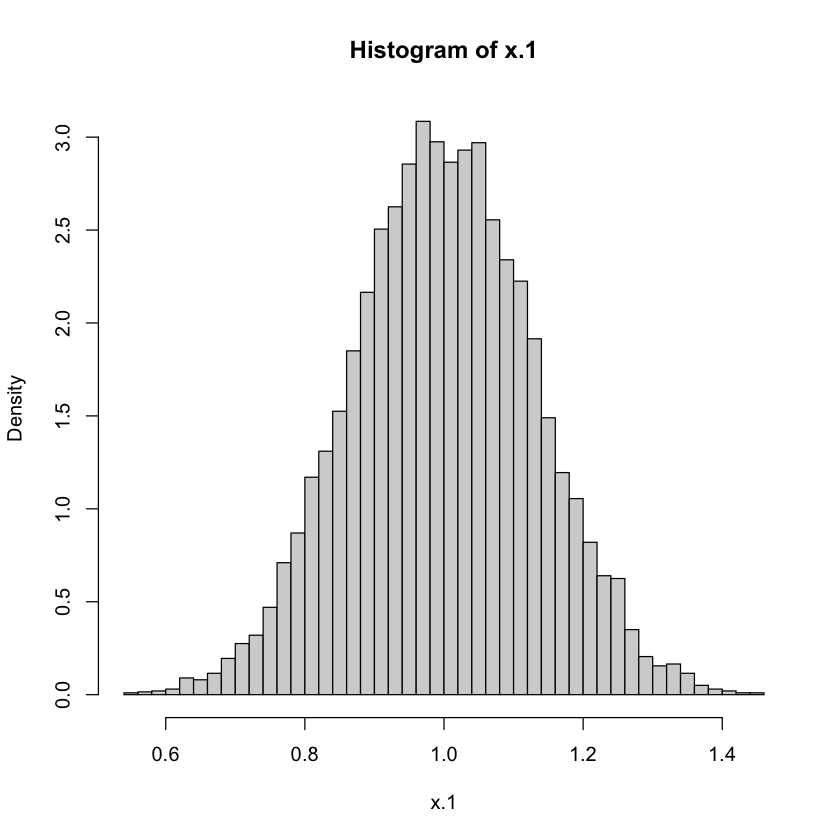

HTML widgets cannot be represented in plain text (need html)

HTML widgets cannot be represented in plain text (need html)

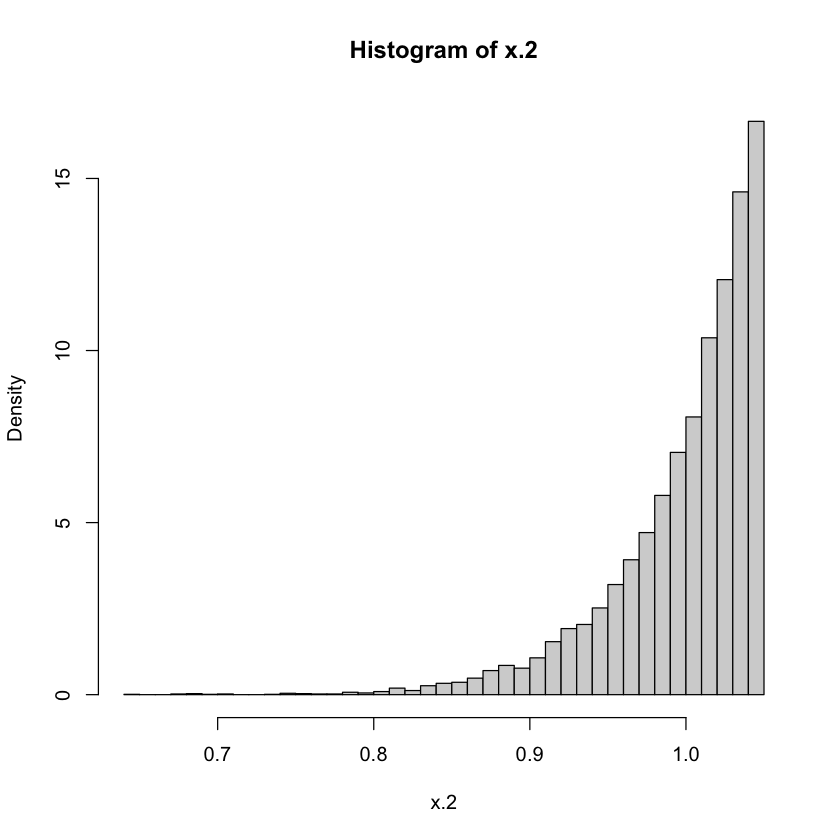

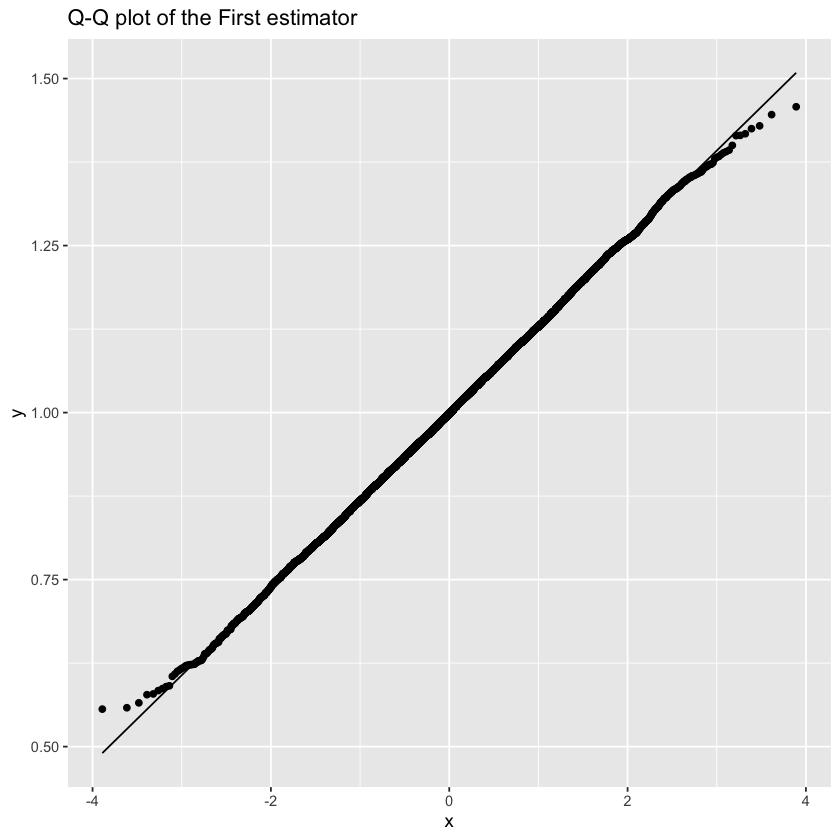

[1] 0.9989774

[1] 0.9997107

[1] 0.01713429

[1] 0.002234207

[1] 7.669068

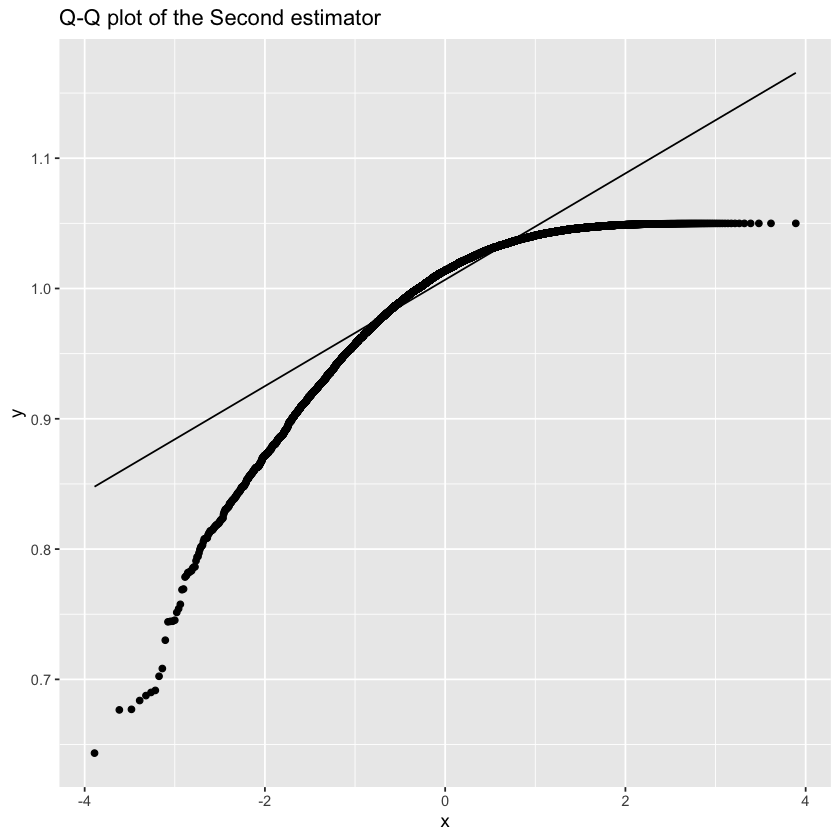

In [30]:
# For the case a = 1, compare two estimators.

n = 20

# First estimator: Sample mean times two

x.1 <- replicate(10000, 2*mean(runif(n)))

# Second estimator: sample maximum times (n+1)/n (to remove the bias)

x.2 <- replicate(10000, (n+1)/n*max(runif(n)))

hist(x.1, breaks = 50, probability = T)
#qqnorm(x.1)

hist(x.2, breaks = 50, probability = T)

#qqnorm(x.2)

df <- data.frame(x=x.1,y=x.2)

fig1 <- plot_ly(df, x = ~x, type = "histogram") %>%
  layout(title = 'Distribution of the First estimator')
fig1

fig2 <- plot_ly(df, x = ~y, type = "histogram") %>%
  layout(title = 'Distribution of the Second estimator')
fig2

# Both sample statistics have a bell shaped distribution.

#qqnorm(x.means)
#qqnorm(x.medians)


p1 <- ggplot(df, aes(sample = x))
p1 + stat_qq() + stat_qq_line()+
  ggtitle ("Q-Q plot of the First estimator")

p2 <- ggplot(df, aes(sample = y))
p2 + stat_qq() + stat_qq_line()+
  ggtitle ("Q-Q plot of the Second estimator")



# The first estimate has a bell shaped distribution
# The second estimate has a highly skewed distribution

mean(x.1)
mean(x.2)

# Both are unbiased

var(x.1)

var(x.2)

#  relative efficiency:

var(x.1)/var(x.2)

# The second estimator is seven times as efficient as the first one.

# Extra: Past Exam Questions

## Problem 1: Which of the following statments are true? __________

A. In the case where more samples we get, closer we get to the expected value of the distribution. 

B. The central limit theorem(CLT) means that the sum of a large number of independent random variables will be very close to normal. 

C. CLT says $\sqrt n (\bar X_n - \mu )/ \sigma \sim N(0,1)$

D. CLT tells us that for independent and identically distributed random variables, as the sample size grows the sample mean gets closer to the mean of the underlying distribution.

## Problem 2: Which of the following statments are true? __________

Let's assume that the random variables $X_1,X_2,X_3,X_4,X_5$ are independently and identical distributed with mean $\mu$ and variance $\sigma^2$.

A. $\hat \mu_1 = \frac {2X_1+X_2+3X_3+2X_4+X_5}{6}$ and $\hat \mu_2 = \bar X$ are both unbiased estimators of $\mu$.

B. $\tilde \mu =\frac {\hat \mu_3}{2}$ (where $\hat \mu_3 = \frac {X_1+X_2+5X_3+2X_4+3X_5}{6}$ ) and $\hat \mu_2 = \bar X$ are both unbiased estimators of $\mu$.

C. $\hat \mu_2$ is relatively more efficient than $\tilde \mu$ because $Var(\hat \mu_2) < Var(\tilde \mu)$.

D. When the model complexity increases the bias and variance increases which results in high training error.

## Problem 3

Consider the probability distribution with density
$$
f(x|\theta) = \begin{cases}
(\frac{1}{\theta} + 1) x^{1/\theta} \quad (0 \le x \le 1) \\
0 \quad \text{otherwise}
\end{cases}
$$
where $\theta > 0$ is unknown. 

a) Set up the likelihood function for a sample $x_1, x_2, \dots, x_n)$ from such a distribution.

b) Show algebraically that the log-likelihood for such a sample depends only on $L = \frac{1}{n} \sum_i \log x_i$, the mean of the logarithms of the sample.

\textit{Do not derive the maximum likelihood estimate for $\theta$.}
